<a href="https://colab.research.google.com/github/cyborgrob/tinder_vision/blob/main/tinder_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Unzip the downloaded data into Google Drive (only need to run once and then data will be uploaded to drive)
# !unzip "/content/drive/MyDrive/Tinder Vision/tinder.zip" -d "drive/My Drive/Tinder Vision/"

# Tinder Project (Hot or Not) 🔥
This notebook project will attempt to build a model that can classify girls as "Yes (Swipe Right)" or "No (Swipe Left)" as the first stage in an app that can auto-swipe on Tinder "intelligently" (as opposed to most bots that only swipe right on everyone).

## 1. Problem Definition
When presented with the profile of a woman on Tinder (or another swipe-based dating app), we want our model to be able to automatically swipe left or right based on our preferences.

## 2. Data
The data we're using initially will be a dataset from Kaggle for man/woman classification: https://www.kaggle.com/datasets/playlist/men-women-classification

We will break down the data set to include only the women, along with truth labels or "Yes" or "No" aligning to our preferences.

**Update:**
We used the above data intially, but now we have switched to a more practical dataset of Instagram photos: https://www.kaggle.com/datasets/shmalex/instagram-images/data

## 3. Evaluation
The evaluation will be a file with predictions for series of images compared with the ground truth labels. We'd like to see at least a 70% success/alignment rate with the model.

**Update:** We were able to reach very close to 70% with the initial dataset. With the new dataset, we are hoping to see at least 90%.

## 4. Features
* We're using images (unstructured data), so it'll probably be best to use deep learning
* There are only two classes/labels - "Yes", for girls we would swipe right on, or "No" for girls we would swipe left on
* There are a total of 1,912 images in our initial data set. We'll manually split this into training, validation, and test sets. We may add additional data later in the project, but this is what we'll start with **Update:** There are now 8,032 images in the total dataset




### Getting our workspace ready

In [ ]:
# Import necessary tools
import tensorflow as tf
import tensorflow_hub as hub
print("TF version:" + tf.__version__)
print("TF Hub version:" + hub.__version__)

# Check if GPU available
print("GPU", "available :)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version:2.15.0
TF Hub version:0.15.0
GPU available :)


### Getting our Data ready (turning into Tensors)
With image data, we'll want to turn our data into numerical form (Tensors). Let's do that.

In [ ]:
# Check out the labels of our data
import pandas as pd
# df = pd.read_csv("drive/MyDrive/Tinder Vision/labels.csv") # Original labels
df = pd.read_csv("drive/MyDrive/Tinder Vision/insta_labels.csv")
df.head()


,filename,label
0,7mjSEfhx-z.jpg,1
1,8H0Fnmja-z.jpg,1
2,Bb7XQMOB5-z.jpg,1
3,BbHtn0Rjj-Z.jpg,1
4,BbmakcflG-z.jpg,0


In [ ]:
df.label.value_counts()

1    6380
0    1652
Name: label, dtype: int64

<Axes: >

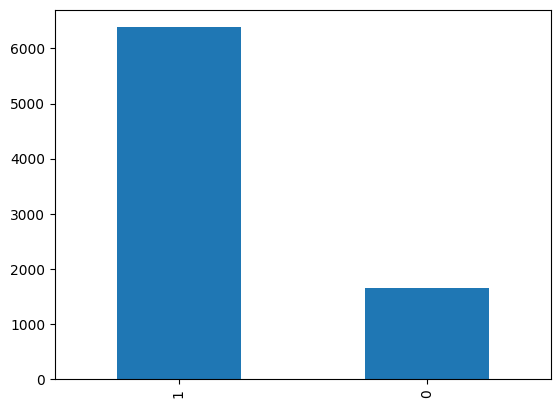

In [ ]:
df.label.value_counts().plot.bar()

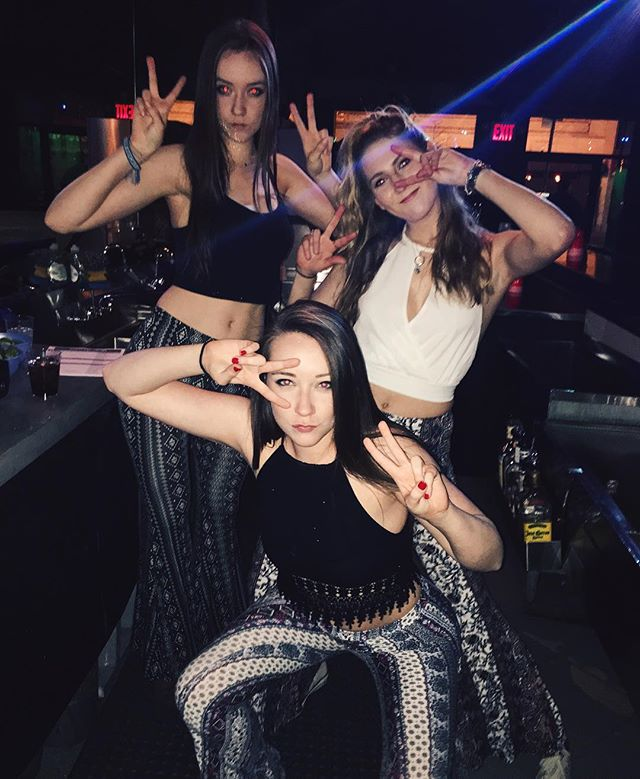

In [ ]:
# Let's view an image
from IPython.display import Image
Image("drive/MyDrive/Tinder Vision/women/BD_jJ4mol-Z.jpg")

In [ ]:
# Create list of filenames
filenames = ["drive/MyDrive/Tinder Vision/women/" + fname for fname in df["filename"]]
filenames[:10]

['drive/MyDrive/Tinder Vision/women/7mjSEfhx-z.jpg',
 'drive/MyDrive/Tinder Vision/women/8H0Fnmja-z.jpg',
 'drive/MyDrive/Tinder Vision/women/Bb7XQMOB5-z.jpg',
 'drive/MyDrive/Tinder Vision/women/BbHtn0Rjj-Z.jpg',
 'drive/MyDrive/Tinder Vision/women/BbmakcflG-z.jpg',
 'drive/MyDrive/Tinder Vision/women/BciFgrfHH-z.jpg',
 'drive/MyDrive/Tinder Vision/women/BciKO-rB6-z.jpg',
 'drive/MyDrive/Tinder Vision/women/BDjoIsMIH-Z.jpg',
 'drive/MyDrive/Tinder Vision/women/BdUsXcUhX-z.jpg',
 'drive/MyDrive/Tinder Vision/women/BD_jJ4mol-Z.jpg']

In [ ]:
# Check whether list of filenames equals the number of images
import os
if len(os.listdir("drive/MyDrive/Tinder Vision/women")) == len(filenames):
  print("Filenames equals number of images. Proceed.")
else:
  print("Filenames does not match number of images. Check DataFrame")

Filenames equals number of images. Proceed.


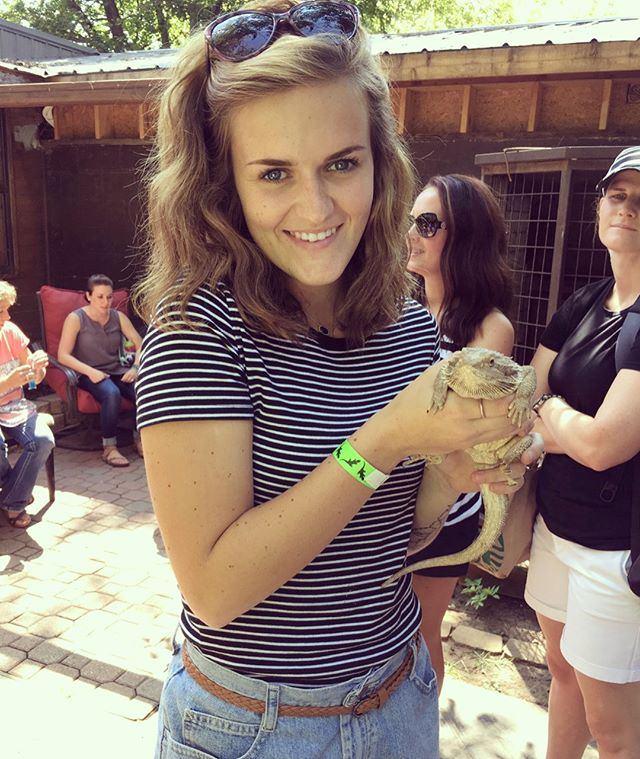

In [ ]:
# One more check
Image(filenames[183])

In [ ]:
df["label"][183] # 1 = yes/swipe right, 0 = no/swipe left

1

Let's get our labels into a numpy array.

In [ ]:
import numpy as np
labels = df.label.values
labels

array([1, 1, 1, ..., 1, 1, 1])

In [ ]:
# Create a boolean array
boolean_labels = labels.astype(bool)
boolean_labels

array([ True,  True,  True, ...,  True,  True,  True])

In [ ]:
len(boolean_labels)

8032

In [ ]:
# Check unique label values (should just be 0 and 1)
unique_labels = np.unique(labels)
unique_labels

array([0, 1])

In [ ]:
# Turn a single label array into an array of booleans
print(labels[0])
labels[0] == unique_labels

1


array([False,  True])

In [ ]:
# Turn every label into an array of booleans
boolean_labels = [label == unique_labels for label in labels]
boolean_labels[:10]

[array([False,  True]),
 array([False,  True]),
 array([False,  True]),
 array([False,  True]),
 array([ True, False]),
 array([ True, False]),
 array([ True, False]),
 array([ True, False]),
 array([False,  True]),
 array([False,  True])]

### Creating our own Validation & Test sets
Since our dataset is just one big blob of data with no separation for training, validation, and test, we're going to create our own.

In [ ]:
# import train_test_split
from sklearn.model_selection import train_test_split

df.head()

,filename,label
0,7mjSEfhx-z.jpg,1
1,8H0Fnmja-z.jpg,1
2,Bb7XQMOB5-z.jpg,1
3,BbHtn0Rjj-Z.jpg,1
4,BbmakcflG-z.jpg,0


In [ ]:
filenames[:10], boolean_labels[:10]

(['drive/MyDrive/Tinder Vision/women/7mjSEfhx-z.jpg',
  'drive/MyDrive/Tinder Vision/women/8H0Fnmja-z.jpg',
  'drive/MyDrive/Tinder Vision/women/Bb7XQMOB5-z.jpg',
  'drive/MyDrive/Tinder Vision/women/BbHtn0Rjj-Z.jpg',
  'drive/MyDrive/Tinder Vision/women/BbmakcflG-z.jpg',
  'drive/MyDrive/Tinder Vision/women/BciFgrfHH-z.jpg',
  'drive/MyDrive/Tinder Vision/women/BciKO-rB6-z.jpg',
  'drive/MyDrive/Tinder Vision/women/BDjoIsMIH-Z.jpg',
  'drive/MyDrive/Tinder Vision/women/BdUsXcUhX-z.jpg',
  'drive/MyDrive/Tinder Vision/women/BD_jJ4mol-Z.jpg'],
 [array([False,  True]),
  array([False,  True]),
  array([False,  True]),
  array([False,  True]),
  array([ True, False]),
  array([ True, False]),
  array([ True, False]),
  array([ True, False]),
  array([False,  True]),
  array([False,  True])])

In [ ]:
# Split data into X & y
X = filenames
y = boolean_labels

# Split features (X) and labels (y) into train and test sets first
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.15, random_state=9)

# Further split the train sets into true training set as well as a validation set
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=.18, random_state=9) # test_size is .18 because that number would result in approximately equal val and test sets

len(y_train), len(y_val), len(y_test) # adds up to 8032, the length of the total dataset

(5598, 1229, 1205)

In [ ]:
# Let's have a look at the training data
X_train[:5], y_train[:5]

(['drive/MyDrive/Tinder Vision/women/BwjPhI9nDk_.jpg',
  'drive/MyDrive/Tinder Vision/women/BxCrVIdHAlt.jpg',
  'drive/MyDrive/Tinder Vision/women/Bwr1Pjqg-dT.jpg',
  'drive/MyDrive/Tinder Vision/women/BxKkk02gij_.jpg',
  'drive/MyDrive/Tinder Vision/women/BfZF4hCBU3Z.jpg'],
 [array([False,  True]),
  array([False,  True]),
  array([ True, False]),
  array([False,  True]),
  array([False,  True])])

### Preprocessing Images (turning images into Tensors)
To preprocess our images into tensors, we're going to write a function which does a few things:

* Take an image filepath as input
* Use TensorFlow to read the filepath and save it to a variable image
* Turn our image (a jpg) into Tensors
* Normalize our image (convert color channel values from 0-255 to 0-1 scale)
* Resize the image to be a size of (224, 224) (it's standard practice to resize all images into a standardized size)
* Return the modified image

Before we do, let's see what importing an image looks like.

In [ ]:
# Convert image to NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(640, 640, 3)

In [ ]:
image # a bunch of RGB values between 0 and 256

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [ ]:
image.max(), image.min()

(255, 0)

In [ ]:
# Turn image into a constant Tensor
tf.constant(image)

# A tensor can run on the much faster GPU; an array can only run on the slower CPU

<tf.Tensor: shape=(640, 640, 3), dtype=uint8, numpy=
array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 25

Now that we've seen what an image looks like as a Tensor, let's make a function to preprocess them.
1. Take an image filepath as input
2. Use TensorFlow to read the filepath and save it to a variable `image`
3. Turn our `image` (a jpg) into Tensors
4. Normalize our image (convert color channel values from 0-255 to 0-1 scale)
5. Resize the `image` to be a size of (224, 224) (it's standard practice to resize all images into a standardized size)
6. Return the modified `image`

In [ ]:
# Define image size (a lot of machine learning is lining up the shape of your inputs with the model that you're using)
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn the jpg image into numerical tensor with three color channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the color channel values from 0 to 255 scale to 0 to 1 scale (called "normalization")
  image = tf.image.convert_image_dtype(image=image, dtype=tf.float32)
  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(images=image, size=[img_size, img_size])

  return image

### Turning our Data into batches
Why turn our data into batches?

Let's say you're trying to process 10,000 images in one go - they might not all fit into memory!

So that's why we do about 32 images at a time (you can manually adjust the batch size if needed).

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this:
`(image, label)`.

In [ ]:
# Create a simple function that returns a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image path name and its associated label, processes the image, and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return (image, label)

In [ ]:
# Demo of the above function
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         ...,
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785]],
 
        [[0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         ...,
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785]],
 
        [[0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         ...,
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785]],
 
        ...,
 
        [[0.9960785, 0.9960785, 0.9960785],
         [0.9960785, 0.9960785, 0.9960785]

Now that we've got a way to turn our data into tuples of Tensors in the form (image, label), let's make a function to turn all of our data (X & y) into batches.

In [ ]:
tf.constant(y[42])

<tf.Tensor: shape=(2,), dtype=bool, numpy=array([ True, False])>

In [ ]:
# Define the batch size. 32 is a good place to start.
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (X) and label (y) pairs. Shuffles the data if it's training data, but doesn't shuffle if it's validation data. Also accepts test data as input.
  """
  # If data is test data (we will have labels in our case because we've added them ourselves)
  if test_data:
    print("Creating test data batches...")
    # Turn filepaths into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Create (image, label) tuples. This also turns the image path into a preprocessed image (because `get_image_label` calls `process_image`). Then batch the data.
    data_batch = data.map(get_image_label).batch(batch_size=batch_size)
    return data_batch

  # If the data is a validation set, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Create (image, label) tuples. This also turns the image path into a preprocessed image (because `get_image_label` calls `process_image`). Then batch the data.
    data_batch = data.map(get_image_label).batch(batch_size=batch_size)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before calling/mapping the process_image function is faster than shuffling the images
    data.shuffle(buffer_size=len(X)) # buffer_size=len(X) means to shuffle the whole list
    # Create (image, label) tuples. This also turns the image path into a preprocessed image (because `get_image_label` calls `process_image`). Then batch the data.
    data_batch = data.map(get_image_label).batch(batch_size=batch_size)
    return data_batch


In [ ]:
# Create training and validation data batches
train_data = create_data_batches(X=X_train, y=y_train)
val_data = create_data_batches(X=X_val, y=y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 2), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 2), dtype=tf.bool, name=None)))

### Visualizing Data batches
Our data is now in batches. However, these can be a little hard to understand. Let's visualize them.

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch.
  """
  # Set up the figure
  plt.figure(figsize=(15, 15))
  # Loop through 25 (for displaying 25 images)
  for n in range(25):
    # Create subplots (5 rows, 5 columns)
    plt.subplot(5, 5, n+1) # 5 rows, 5 columns, i+1 position
    # Show an image
    plt.imshow(images[n])
    # Add the image label as the title
    plt.title(unique_labels[labels[n].argmax()])
    # Turn the grid lines off
    plt.axis("off")

In [ ]:
# Convert dataset into iterators
train_images, train_labels = next(train_data.as_numpy_iterator())
len(train_images), len(train_labels)

(32, 32)

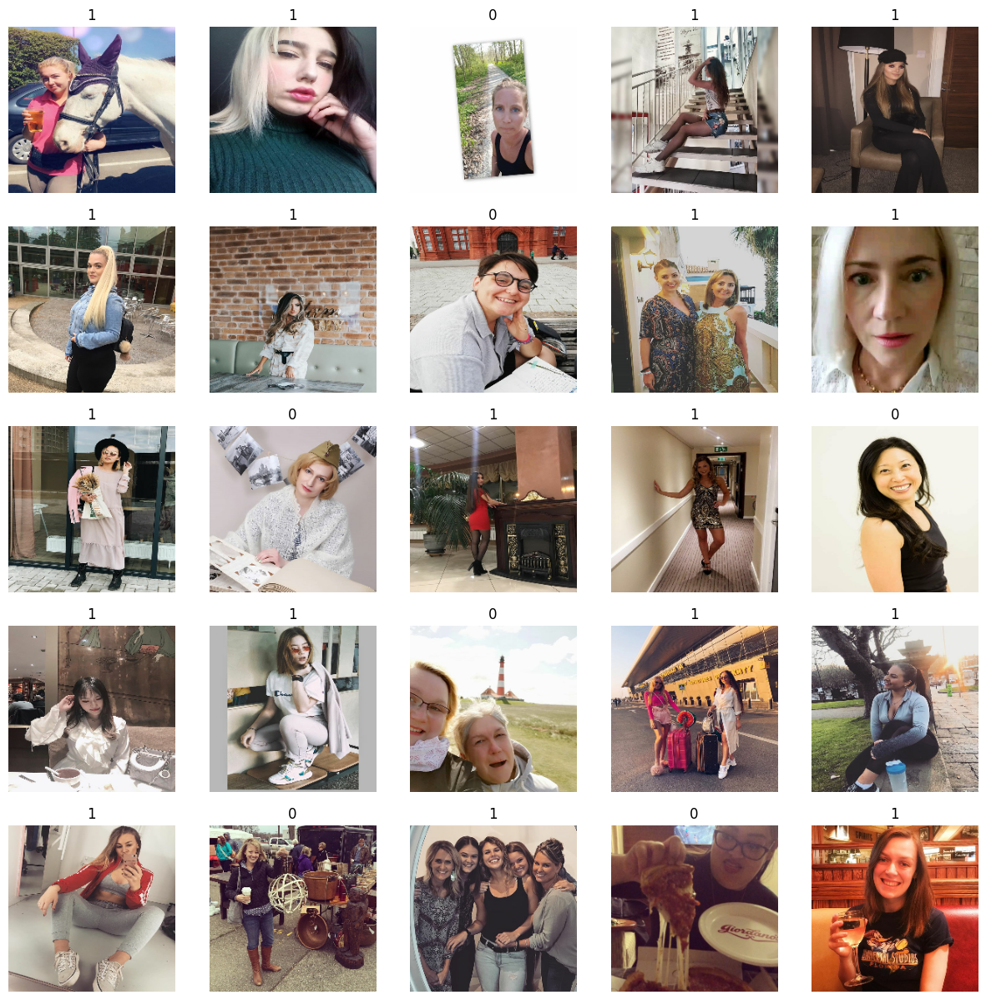

In [ ]:
# Now let's visualize the data in a training batch
show_25_images(images=train_images, labels=train_labels)

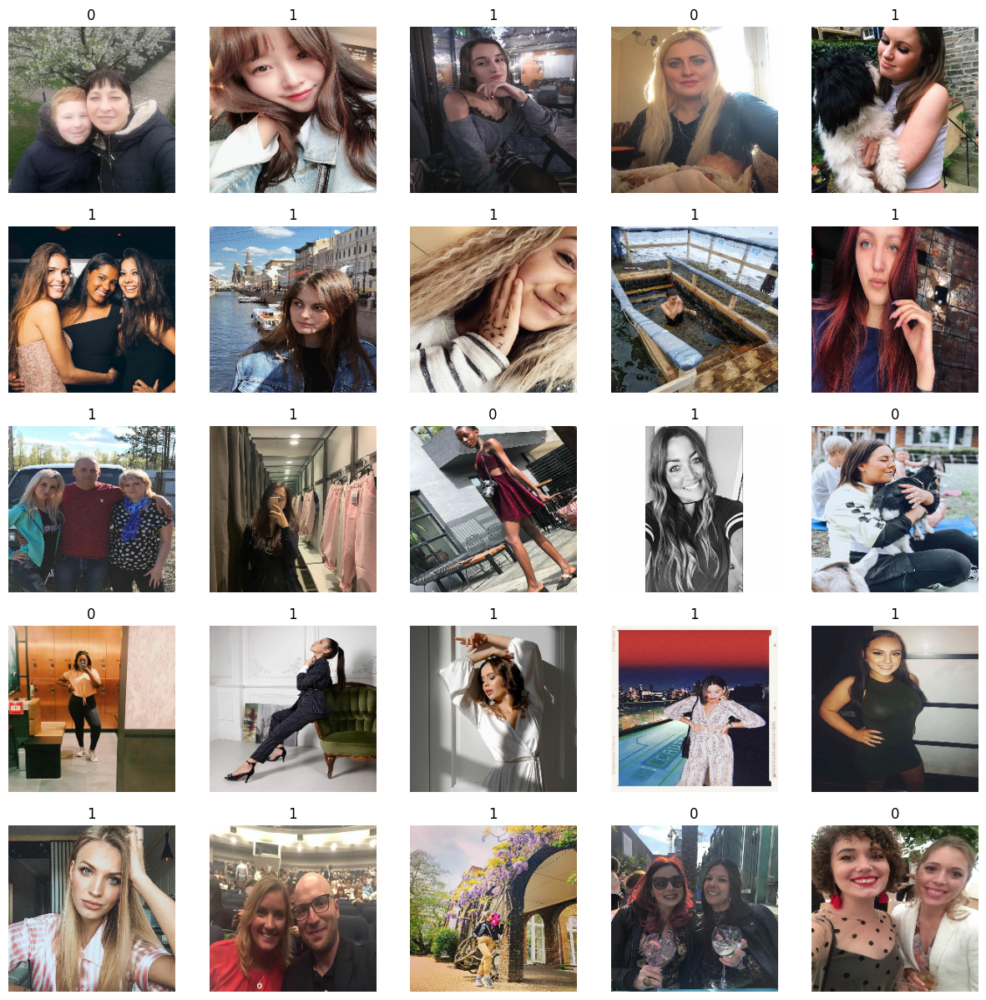

In [ ]:
# Now let's visualize our validation set
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## 5. Modeling
### Building a model
Before we build a model, there are a few things we need to define:
1. The input shape (our images shape, in the form of Tensors) to our model.
2. The output shape (image labels, in the form of Tensors) of our model.
3. The URL of the model we want to use from TensorFlow Hub/Kaggle: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2

In [ ]:
# Set up input shpae to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # Should match the shape of our data batch which we saw above. Batch, height, width, color channels

# Set up output shape
OUTPUT_SHAPE = len(unique_labels)

# Set up model URL from TensorFlow Hub (Kaggle)
MODEL_URL = "https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2"

Now that we've got our inputs, outputs, and model ready to go, let's put them together into a Keras Deep Learning model!

Knowing this, let's create a function which:
* Takes the input shape, output shape, and the model we've chosen as parameters
* Defines the layers in a Keras model in a sequential fashion (eg, do this first, then this, then that)
* Compiles the model (says how it should be evaluated and improved)
* Builds the model (tells the model the input shape it'll be getting)
* Returns the model

All of these steps can be found here: https://www.tensorflow.org/guide/keras


In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with: " + model_url)

  # Set up the model layers
  model = tf.keras.Sequential([
      hub.KerasLayer(model_url), # layer 1, input layer
      tf.keras.layers.Dense(units=output_shape, activation="sigmoid") # layer 2, output layer
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.BinaryCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=["accuracy"],
  )

  # Build the model
  model.build(input_shape)

  return model

In [ ]:
model = create_model()
model.summary()

Building model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 2)                 2004      
                                                                 
Total params: 5434717 (20.73 MB)
Trainable params: 2004 (7.83 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


### Creating Callbacks
Callbacks are helper functions a model can use during training to do such things as save its progress, check its progress, or stop training early if a model stops improving.

We'll create two callbacks - one for TensorBoard which helps track our model's progress, and another for early stopping, which prevents our model from training too long/overfitting.

### TensorBoard Callback
To set up a TensorBoard callback, we'll need to do 3 things:
1. Load the TensorBoard notebook extension
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function
3. Visualize our model's training logs with the `%tensorboard` magic function (we'll do this after model training)

In [ ]:
# Load tensorboard notebook extension
%load_ext tensorboard

In [ ]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing tensorboard logs
  logdir = os.path.join("drive/MyDrive/Tinder Vision/logs/",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(log_dir=logdir)

### Early Stopping Callback
Early stopping helps prevent our model from overfitting by stopping training if a certain metric stops improving.

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [ ]:
# Create early stopping callback
PATIENCE = 15
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", patience=PATIENCE)

### Training a Model (on a subset of data)


In [ ]:

NUM_EPOCHS = 100 #@param {type: "slider", min: 10, max: 100, step: 10}

In [ ]:
# Check to make sure we're still running on a GPU
print("GPU", "available :)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available :)


Let's create a function that trains a model.
* Create a model using `create_model()`
* Setup a TensorBoard callback using `create_tensorboard_callback()`
* Call the `fit()` function on our model, passing it the training data, validation data, number of epochs (`NUM_EPOCHS`), and the callbacks we'd like to use
* Return the model

In [ ]:
# Create a function that creates a model (by calling `create_model()` and then trains it and returns the trained model
def train_model():
  """
  Creates a model, trains it, and returns the trained model.
  """
  # Create model
  model = create_model()

  # Create a new tensorboard session every time we create a model
  tensorboard = create_tensorboard_callback()

  # Fit model
  model.fit(
      x=train_data,
      epochs=NUM_EPOCHS,
      validation_data=val_data,
      validation_freq=1,
      callbacks=[tensorboard, early_stopping],
  )
  # Return the fitted model
  return model


In [ ]:
# Fit our model to the data
model = train_model()

Building model with: https://www.kaggle.com/models/google/mobilenet-v2/frameworks/TensorFlow2/variations/130-224-classification/versions/2
Epoch 1/100
175/175 [==============================] - 159s 871ms/step - loss: 0.5675 - accuracy: 0.7740 - val_loss: 0.5041 - val_accuracy: 0.8031
Epoch 2/100
175/175 [==============================] - 51s 291ms/step - loss: 0.4744 - accuracy: 0.8053 - val_loss: 0.4892 - val_accuracy: 0.7966
Epoch 3/100
175/175 [==============================] - 47s 269ms/step - loss: 0.4545 - accuracy: 0.8112 - val_loss: 0.4857 - val_accuracy: 0.7893
Epoch 4/100
175/175 [==============================] - 50s 284ms/step - loss: 0.4441 - accuracy: 0.8149 - val_loss: 0.4852 - val_accuracy: 0.7811
Epoch 5/100
175/175 [==============================] - 51s 289ms/step - loss: 0.4374 - accuracy: 0.8181 - val_loss: 0.4859 - val_accuracy: 0.7795
Epoch 6/100
175/175 [==============================] - 47s 270ms/step - loss: 0.4324 - accuracy: 0.8198 - val_loss: 0.4870 - val_a

### Checking the TensorBoard logs
The TensorBoard magic function (`%tensorboard`) will access the log directory we created earlier and visualize its contents.

In [ ]:
%tensorboard --logdir drive/MyDrive/Tinder\ Vision/logs

<IPython.core.display.Javascript object>

### Making and Evaluationg Predictions with a Trained model

In [ ]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 2), dtype=tf.bool, name=None))>

In [ ]:
# Make predictions on the validation data (not used to train on with `model.fit()`, just used to evaluate loss; see https://www.tensorflow.org/api_docs/python/tf/keras/Sequential#fit)
predictions = model.predict(val_data, verbose=1)
predictions[:10]

39/39 [==============================] - 22s 259ms/step


array([[0.8477067 , 0.18366918],
       [0.07076933, 0.9217709 ],
       [0.02427795, 0.97009194],
       [0.2186172 , 0.82144004],
       [0.71897763, 0.15914878],
       [0.01353354, 0.9877127 ],
       [0.24055776, 0.7906911 ],
       [0.06400819, 0.91191524],
       [0.12028452, 0.94400364],
       [0.09992858, 0.90827155]], dtype=float32)

In [ ]:
predictions.shape

(1229, 2)

In [ ]:
len(y_val)

1229

In [ ]:
len(unique_labels)

2

In [ ]:
predictions[42]

array([0.20841573, 0.83257455], dtype=float32)

These are the probabilities the model has assigned to each label (1 or 0 eg, yes or no). They don't add up to 1. It will guess whichever one has the higher probability (I would assume).

In [ ]:
# First prediction
index = 42
print(f"Max value (probability of prediction): {np.max(predictions[index])}")
print(f"Max index: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_labels[np.argmax(predictions[index])]}") # What's the label? 1 = yes/swipe right, 0 = no/swipe left

Max value (probability of prediction): 0.8325745463371277
Max index: 1
Predicted label: 1


Having the above functionality is great, but we want to be able to do it at scale. And it would be even better if we could see the image the prediction is being made on!

**Note:** Prediction probabilities are also known as confidence levels.

In [ ]:
# Turn prediction probablities into their respective labels (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Takes an array of predictions probabilities and returns an array of the actual labels (1 or 0).
  """
  return unique_labels[np.argmax(prediction_probabilities)]

In [ ]:
# Get a prediction label based on array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

0

In [ ]:
val_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 2), dtype=tf.bool, name=None))>

Now since our val_data is still in a batch Dataset, we'll want to 'unbatchify' it to make predictions on the validation images and then compare those predictions to the validation labels (truth labels).

In [ ]:
# Create a function to unbatch a batch dataset
# Here is the code not function-ized
images_ = []
labels_ = [] # The '_' is so we don't overwrite the variable 'labels' we used before

# Loop through unbatched data
for image, label in val_data.unbatch().as_numpy_iterator():
  images_.append(image)
  labels_.append(label)

images_[0], labels_[0]

(array([[[0.5243297 , 0.52825135, 0.49687877],
         [0.462405  , 0.46632656, 0.43495402],
         [0.52615047, 0.5339936 , 0.49085638],
         ...,
         [0.36152434, 0.36152434, 0.3536812 ],
         [0.3701281 , 0.3701281 , 0.3639657 ],
         [0.37150902, 0.37150902, 0.37150902]],
 
        [[0.51556623, 0.5194878 , 0.48811525],
         [0.4644258 , 0.46834737, 0.43697482],
         [0.34411767, 0.3519608 , 0.30882356],
         ...,
         [0.38795522, 0.38795522, 0.38231316],
         [0.3597441 , 0.3590838 , 0.3689078 ],
         [0.4283504 , 0.4244889 , 0.44677755]],
 
        [[0.4683473 , 0.47226888, 0.44089633],
         [0.44427773, 0.4481993 , 0.41682675],
         [0.40896362, 0.41680676, 0.3736695 ],
         ...,
         [0.3677867 , 0.3677867 , 0.3705881 ],
         [0.387375  , 0.38345343, 0.40806332],
         [0.3740105 , 0.36756793, 0.40650353]],
 
        ...,
 
        [[0.227451  , 0.2509804 , 0.29803923],
         [0.21062437, 0.23415378, 0.28121

In [ ]:
get_pred_label(labels_[0]) # actual label

0

In [ ]:
get_pred_label(predictions[0]) # predicted label

0

In [ ]:
# Create a function to do this
def unbatchify(dataset):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays of images and labels.
  """
  image_list = []
  label_list = []

  # Loop through unbatched data
  for image, label in dataset.unbatch().as_numpy_iterator():
    image_list.append(image)
    label_list.append(unique_labels[np.argmax(label)])

  return image_list, label_list

In [ ]:
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.5243297 , 0.52825135, 0.49687877],
         [0.462405  , 0.46632656, 0.43495402],
         [0.52615047, 0.5339936 , 0.49085638],
         ...,
         [0.36152434, 0.36152434, 0.3536812 ],
         [0.3701281 , 0.3701281 , 0.3639657 ],
         [0.37150902, 0.37150902, 0.37150902]],
 
        [[0.51556623, 0.5194878 , 0.48811525],
         [0.4644258 , 0.46834737, 0.43697482],
         [0.34411767, 0.3519608 , 0.30882356],
         ...,
         [0.38795522, 0.38795522, 0.38231316],
         [0.3597441 , 0.3590838 , 0.3689078 ],
         [0.4283504 , 0.4244889 , 0.44677755]],
 
        [[0.4683473 , 0.47226888, 0.44089633],
         [0.44427773, 0.4481993 , 0.41682675],
         [0.40896362, 0.41680676, 0.3736695 ],
         ...,
         [0.3677867 , 0.3677867 , 0.3705881 ],
         [0.387375  , 0.38345343, 0.40806332],
         [0.3740105 , 0.36756793, 0.40650353]],
 
        ...,
 
        [[0.227451  , 0.2509804 , 0.29803923],
         [0.21062437, 0.23415378, 0.28121

Now we've got ways to get:
* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's make some functions to make them all a bit more visual.

We'll create a function which:
* Takes an array of prediction probabilities, an array of truth labels, and an array of images and an integer
* Convert the prediction probabilities to a predicted label
* Plot the predicted label, it's predicted probability, the truth label, and the target image on a single plot


In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth, and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  # Change the plot title to be Predicted, Probability of Predicted, and Truth label
  plt.title("Pred: {} // {:2.0f}% // Truth: {}".format(pred_label,
                                    np.max(pred_prob) * 100,
                                    true_label),
                                    color=color)


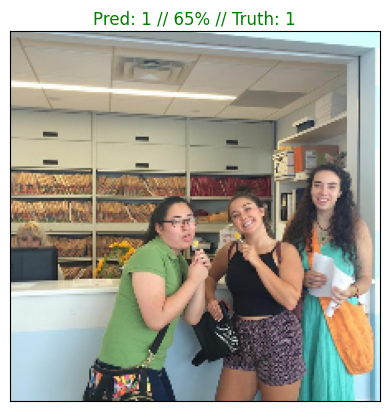

In [ ]:
plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=28)

Now we've got one function to visualize our model's prediction on one image. Let's make another that will allow us to view its predictions on multiple images.

This function will:
* Take an input of a prediction probabilities array, a ground truth array, and an integer
* Find the predictions using `get_pred_label()`
* Plot the top 10 prediction probability values and labels, coloring the true label green

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plot the probabilities for each of the choices along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the prediction confidence indexes (demonstrated below with predictions[0].argsort())
  pred_indexes = pred_prob.argsort()[::-1]

  # Get the actual prediction confidence values
  pred_values = pred_prob[pred_indexes]

  # Find the prediction labels
  pred_labels = unique_labels[pred_indexes]

  # Set up plot
  top_plot = plt.bar(np.arange(len(pred_labels)),
                     pred_values,
                     color="grey")
  plt.xticks(np.arange(len(pred_labels)),
             labels=pred_labels,
             rotation="vertical")

  # Change color of correct label
  if pred_label == true_label:
    # Where the label is equal to the true label, set the color to green
    top_plot[np.argmax(pred_labels == true_label)].set_color("green")
  else:
    # In cases where the model guessed wrong, set the wrong prediction color to red
    top_plot[np.argmin(pred_labels == true_label)].set_color("red")

  # top_plot[np.argmax(pred_labels == true_label)].set_color("green")

In [ ]:
predictions[0].argsort() # Gives the order of indexes which will sort this array in ascending order (highest probabilities at the end)

array([1, 0])

In [ ]:
predictions[0] # So index 0 is the highest, so it comes last in the .argsort()

array([0.8477067 , 0.18366918], dtype=float32)

In [ ]:
predictions[0].argsort()[::-1] # Reverse the order so the highest probability index comes first

array([0, 1])

In [ ]:
predictions[0][predictions[0].argsort()[::-1]] # Get the actual percentages by indexing predictions[0] with the order

array([0.8477067 , 0.18366918], dtype=float32)

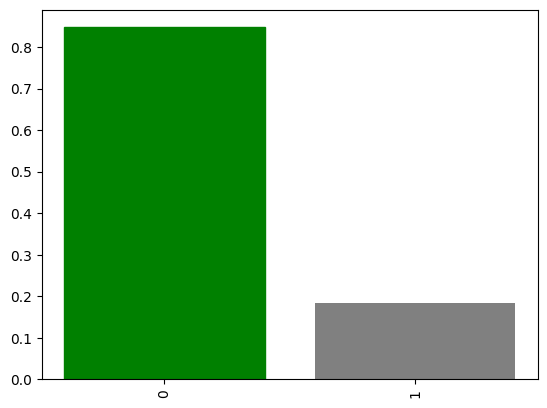

In [ ]:
plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=0)

Now that we've got some functions to help us visualize our predictions and evaluate our model, let's check out a few.

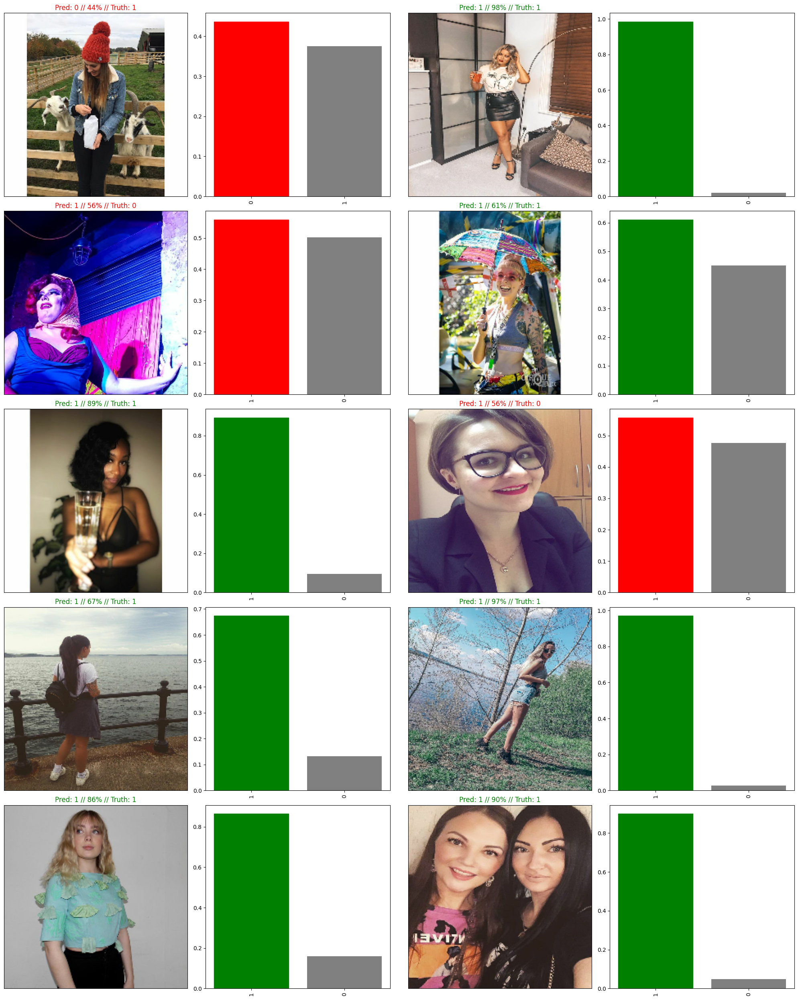

In [ ]:
# Let's check out a few predictions and their values
n_multiplier = 70 # Which index of images to test
num_rows = 5
num_cols = 2
num_images = num_rows * num_cols

plt.figure(figsize=(10 * num_cols, 5 * num_rows))

for n in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*n+1)
  plot_pred(prediction_probabilities=predictions, labels=val_labels, images=val_images, n=n+n_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*n+2)
  plot_pred_conf(prediction_probabilities=predictions, labels=val_labels, n=n+n_multiplier)

plt.tight_layout(h_pad=1.0)
plt.show()


**Challenge:** How would you create a confusion matrix with our model's predictions and true labels?

In [ ]:
y_pred_binary = np.argmax(predictions, axis=1)
y_true_binary = np.argmax(y_val, axis=1)

In [ ]:
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_pred_binary, y_true_binary)
cm

array([[ 64,  83],
       [180, 902]])

In [ ]:
len(y_val) # Sum of items in matrix adds up to length of y_val

1229

### Saving and Reloading a Trained model

In [ ]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a 'models' directory and appends a suffix (string).
  """
  # Create a model directory pathname with the current time
  modeldir = os.path.join("drive/MyDrive/Tinder Vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}")
  model.save(model_path)
  return model_path

In [ ]:
# Create a function to load a trained model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer": hub.KerasLayer})
  return model

Now we've got functions to save and load trained models. Let's make sure they work!

In [ ]:
# Save our basic model
save_model(model, suffix="second-model-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Tinder Vision/models/20240111-10211704968508-second-model-mobilenetv2-Adam.h5


'drive/MyDrive/Tinder Vision/models/20240111-10211704968508-second-model-mobilenetv2-Adam.h5'

In [ ]:
# Load our basic model (Have to make sure it's loading the same model from the previous cell - if running all cells it won't do this)
loaded_basic_model = load_model("drive/MyDrive/Tinder Vision/models/20240111-10211704968508-second-model-mobilenetv2-Adam.h5")

Loading saved model from: drive/MyDrive/Tinder Vision/models/20240111-10211704968508-second-model-mobilenetv2-Adam.h5


In [ ]:
# Evaluate pre-saved model
model.evaluate(val_data)

39/39 [==============================] - 10s 250ms/step - loss: 0.4855 - accuracy: 0.7860


[0.485451340675354, 0.786004900932312]

In [ ]:
# Evaluate loaded model
loaded_basic_model.evaluate(val_data)

39/39 [==============================] - 8s 191ms/step - loss: 0.4855 - accuracy: 0.7860


[0.485451340675354, 0.786004900932312]

**Note:** If your training data set is very large, it's a good idea to train your model on only a small data set initially (say, 1000 items). This way, if there's something wrong with your model, you don't waste a lot of time/resources running through the whole data set.

### Make predictions on test data

In [ ]:
# Create data batches
test_data = create_data_batches(X=X_test, y=y_test, test_data=True)
test_data # Batches should be in same shape as we've seen previously

Creating test data batches...


<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 2), dtype=tf.bool, name=None))>

In [ ]:
# Make predictions on test data
test_preds = model.predict(test_data, verbose=1)

38/38 [==============================] - 144s 4s/step


In [ ]:
test_preds[:10]

array([[0.18914014, 0.74879754],
       [0.01024569, 0.9949456 ],
       [0.10524827, 0.89473516],
       [0.05605085, 0.91983527],
       [0.13847695, 0.9175483 ],
       [0.4712745 , 0.5732691 ],
       [0.07336742, 0.91858137],
       [0.33689702, 0.5682753 ],
       [0.12887804, 0.91378635],
       [0.59992164, 0.3775581 ]], dtype=float32)

In [ ]:
loss, accuracy = model.evaluate(test_data)

38/38 [==============================] - 8s 206ms/step - loss: 0.5053 - accuracy: 0.7726


In [ ]:
print("Test loss: {}".format(loss))
print("Test accuracy: {}".format(accuracy))

Test loss: 0.5052695274353027
Test accuracy: 0.7726141214370728


In [ ]:
# Unbatch test data
test_images, test_labels = unbatchify(test_data)
test_labels[:10]

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]

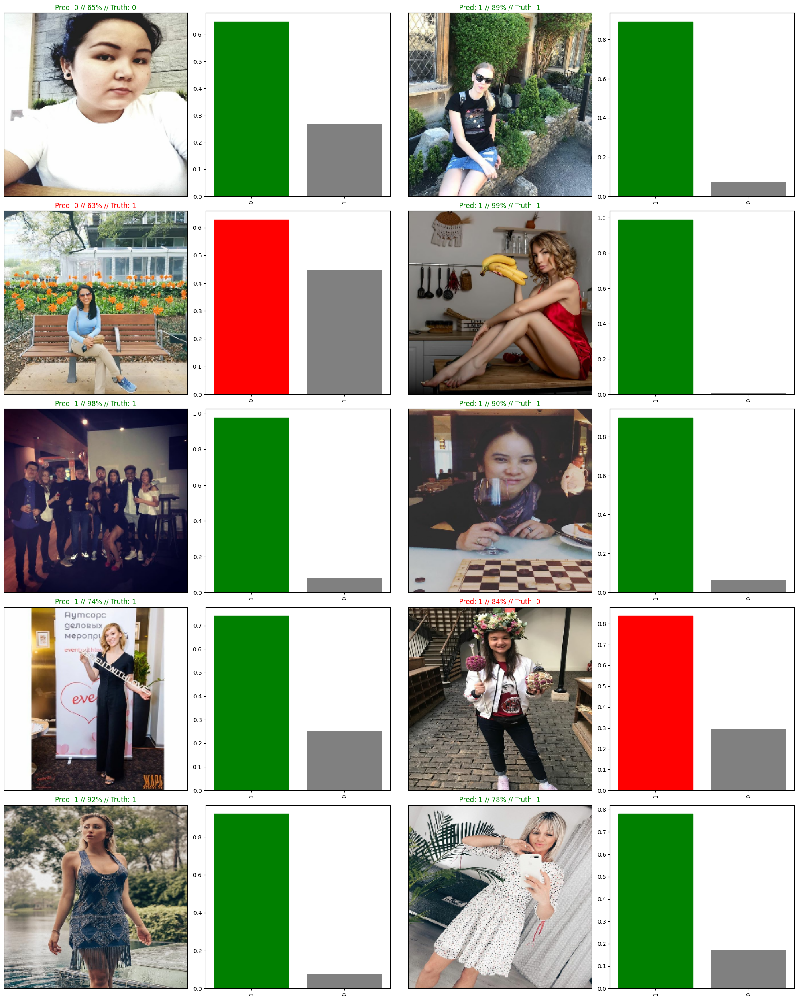

In [ ]:
# Let's check out a few predictions and their values
n_multiplier = 10 # Which index of images to test
num_rows = 5
num_cols = 2
num_images = num_rows * num_cols

plt.figure(figsize=(10 * num_cols, 5 * num_rows))

for n in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*n+1)
  plot_pred(prediction_probabilities=test_preds, labels=test_labels, images=test_images, n=n+n_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*n+2)
  plot_pred_conf(prediction_probabilities=test_preds, labels=test_labels, n=n+n_multiplier)

plt.tight_layout(h_pad=1.0)
plt.show()

## 6. Experimentation
Let's try tuning some hyperparameters. Actually no, let's trying something else. Probably look into getting a better, more appropriate data set rather than movie clips and pictures of Wonder Woman (just checked my notes, and I had a note written that the first step to improving a model is to get more data & perform feature endgineering. Doing that has the greatest payoff in terms of time invested/improvement. Only after that you can think about moving on to hyperparameter tuning).